In [417]:
from Toolbox_ML import *
from sklearn.pipeline import Pipeline
import bootcampviztools as bt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import lightgbm as lgb
from collections import Counter
from lightgbm import LGBMClassifier, LGBMRegressor
from scipy import stats
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import VarianceThreshold, SelectKBest, f_classif, SelectFromModel, RFE, SequentialFeatureSelector
from sklearn.metrics import mutual_info_score, classification_report, median_absolute_error, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV
from xgboost import XGBClassifier, XGBRegressor
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.compose import ColumnTransformer, make_column_selector as selector
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_log_error
import warnings
warnings.filterwarnings('ignore')
import pickle
import re

In [418]:
df1 = pd.read_csv('def_movies_high.csv')
df2 = pd.read_csv('def_movies_low.csv')
target = 'revenue'

df1.drop(columns=['runtime_ratio','lead_actor','supporting_actor_1','supporting_actor_2','director','writer', 'title','cast'], inplace=True)
df2.drop(columns=['runtime_ratio','lead_actor','supporting_actor_1','supporting_actor_2','director','writer', 'title','cast'], inplace=True)

In [419]:
print("There are", len(df1), "movies with revenues more than 20M, and", len(df2), "movies with less than 20M")

There are 1230 movies with revenues more than 20M, and 711 movies with less than 20M


- We apply a Label Encoder

In [420]:
cols = ['release_month','decade','season','release_year']
le = LabelEncoder()
for column in cols:
   df1[column] = le.fit_transform(df1[column])
   df2[column] = le.fit_transform(df2[column])

In [421]:
le.classes_

array([1925, 1927, 1931, 1932, 1933, 1935, 1936, 1938, 1939, 1940, 1942,
       1943, 1944, 1945, 1947, 1948, 1950, 1951, 1953, 1954, 1955, 1956,
       1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967,
       1968, 1969, 1970, 1971, 1972, 1973, 1975, 1976, 1977, 1978, 1979,
       1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990,
       1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001,
       2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012,
       2013, 2014, 2015, 2016, 2017, 2021, 2024])

In [422]:
with open('encoder.pkl', 'wb') as f:
    pickle.dump(le, f)

In [423]:
pd.set_option('display.max_columns', 40)
df1

,produced_in_US,runtime,season,revenue,num_production_companies,top_100_actor_count,writer_rank,num_production_countries,decade,budget,actor_rank,has_top_25_writer,release_month,has_top_25_director,in_english,release_year,has_top_25_company,director_rank,company_rank,genre_rank
0,1,113.00,2,18.37,0.69,0.00,6.10,0.69,5,17.50,5.96,0,1,0,1,50,1,5.07,3.18,1.75
1,1,92.00,2,18.26,1.10,0.00,6.03,1.10,6,16.45,6.73,0,1,0,1,58,0,5.76,5.32,2.14
2,1,119.00,0,18.58,0.69,0.00,5.12,0.69,2,13.82,6.23,0,9,0,1,22,0,5.41,5.18,1.10
3,1,122.00,0,19.69,1.10,0.00,4.14,0.69,4,16.52,6.33,0,11,1,1,45,0,3.89,5.07,1.10
4,1,118.00,1,18.37,1.61,0.00,6.58,0.69,5,17.79,6.27,0,7,0,1,51,0,5.75,5.27,1.95
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1225,1,112.00,3,18.33,1.10,0.00,5.85,0.69,5,16.38,6.59,0,4,0,1,47,0,6.06,5.22,2.17
1226,1,128.00,2,19.21,1.39,0.00,4.50,0.69,5,17.91,6.14,1,6,1,1,50,1,3.53,4.77,1.25
1227,1,120.00,0,18.31,1.39,0.00,6.06,0.69,4,17.99,6.52,0,10,0,1,42,0,6.14,5.28,1.98
1228,1,90.00,3,18.96,1.10,0.00,5.60,0.69,5,17.55,6.28,0,4,0,1,50,0,5.31,5.40,1.87


In [424]:
correlation_with_target = abs(df1.corr()[target])
correlation_with_target = correlation_with_target.sort_values(ascending=False)
correlation_with_target

revenue                    1.00
writer_rank                0.83
director_rank              0.80
budget                     0.54
has_top_25_company         0.44
actor_rank                 0.43
company_rank               0.43
has_top_25_director        0.40
top_100_actor_count        0.33
has_top_25_writer          0.29
release_year               0.20
decade                     0.20
runtime                    0.16
produced_in_US             0.16
num_production_companies   0.14
in_english                 0.13
genre_rank                 0.09
num_production_countries   0.09
season                     0.05
release_month              0.03
Name: revenue, dtype: float64

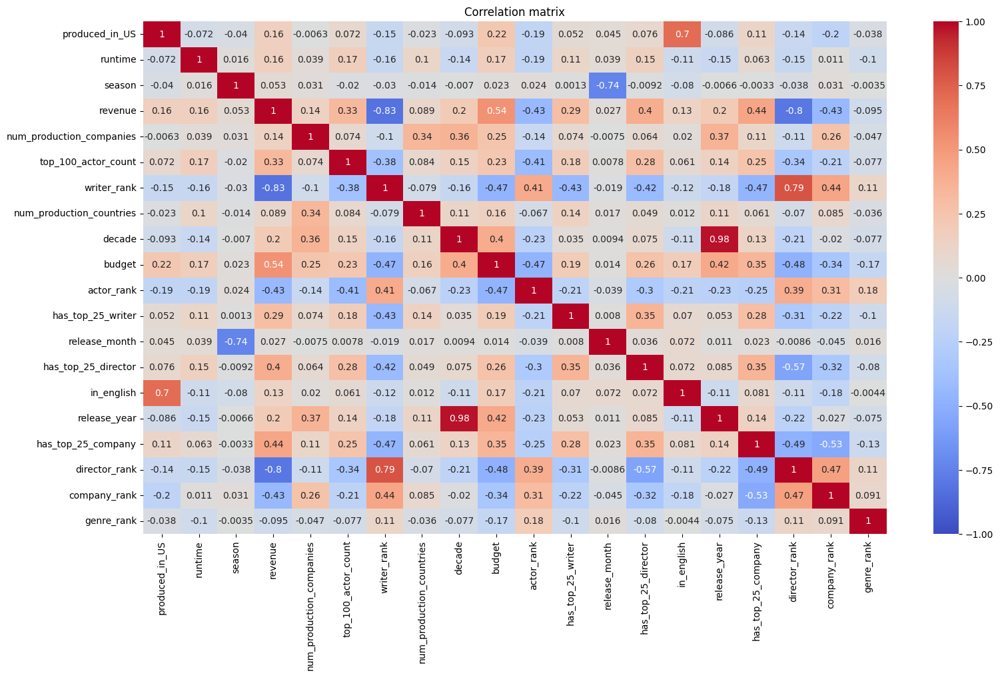

In [425]:
plt.figure(figsize=(18, 10))
sns.heatmap(df1.corr(), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation matrix')
plt.show()

- We drop "decade" in order to avoid colinearity in movies above 20M

In [426]:
df1.drop(columns=['decade'], inplace=True)

Now let's see the movies below 20M, the normally smaller budget ones.

In [427]:
correlation_with_target = abs(df2.corr()[target])
correlation_with_target = correlation_with_target.sort_values(ascending=False)
correlation_with_target

revenue                    1.00
writer_rank                0.38
budget                     0.35
director_rank              0.29
actor_rank                 0.14
company_rank               0.14
produced_in_US             0.12
release_year               0.07
in_english                 0.07
decade                     0.07
has_top_25_company         0.06
num_production_companies   0.05
runtime                    0.05
top_100_actor_count        0.04
genre_rank                 0.03
has_top_25_director        0.02
season                     0.02
num_production_countries   0.02
has_top_25_writer          0.02
release_month              0.02
Name: revenue, dtype: float64

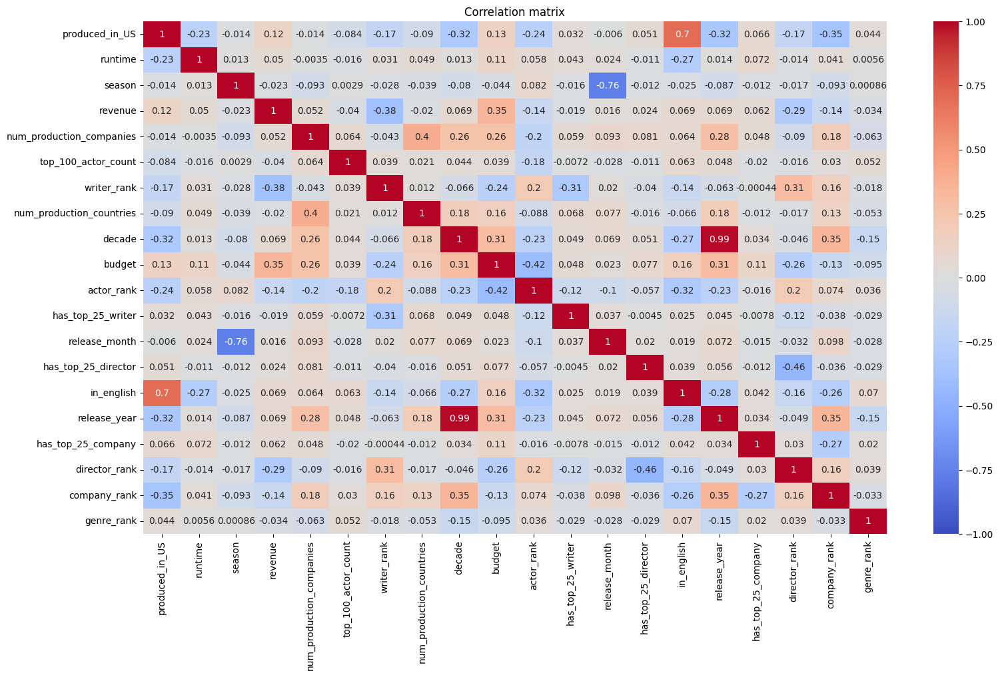

In [428]:
plt.figure(figsize=(18, 10))
sns.heatmap(df2.corr(), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation matrix')
plt.show()

- We also drop "decade" in order to avoid colinearity in movies below 20M.

In [429]:
df2.drop(columns=['decade'], inplace=True)

### Train/Test split

In [430]:
X1 = df1.drop(target, axis = 1)
y1 = df1[target]

X2 = df2.drop(target, axis = 1)
y2 = df2[target]

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.2, random_state=42)
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.2, random_state=42)

In [431]:
X1.head()

,produced_in_US,runtime,season,num_production_companies,top_100_actor_count,writer_rank,num_production_countries,budget,actor_rank,has_top_25_writer,release_month,has_top_25_director,in_english,release_year,has_top_25_company,director_rank,company_rank,genre_rank
0,1,113.00,2,0.69,0.00,6.10,0.69,17.50,5.96,0,1,0,1,50,1,5.07,3.18,1.75
1,1,92.00,2,1.10,0.00,6.03,1.10,16.45,6.73,0,1,0,1,58,0,5.76,5.32,2.14
2,1,119.00,0,0.69,0.00,5.12,0.69,13.82,6.23,0,9,0,1,22,0,5.41,5.18,1.10
3,1,122.00,0,1.10,0.00,4.14,0.69,16.52,6.33,0,11,1,1,45,0,3.89,5.07,1.10
4,1,118.00,1,1.61,0.00,6.58,0.69,17.79,6.27,0,7,0,1,51,0,5.75,5.27,1.95


## Pipeline (XGBoost)

In [432]:
# Seleccionar las columnas numéricas
numeric_features = ['budget', 'top_100_actor_count', 'num_production_countries', 'genre_rank', 'runtime']

# Preprocesamiento de datos
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features)
    ],
    remainder='passthrough'
)

# Crear el pipeline del modelo
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),  # Preprocesador definido previamente
    ('regressor', XGBRegressor(
        alpha=0.005,         # Parámetro de regularización L1 (alpha)
        reg_lambda=0.005,    # Parámetro de regularización L2 (lambda)
        gamma=0.005          # Parámetro de regularización en la reducción mínima de la pérdida (gamma)
    ))
])

In [433]:
param_grid_1 = {
    'regressor__n_estimators': [50, 100, 150],
    'regressor__max_depth': [2,3,4],
    'regressor__learning_rate': [0.01, 0.05],
    'regressor__subsample': [0.5, 0.6, 0.7],
    'regressor__colsample_bytree': [0.8, 0.9, 1],
}

param_grid_2 = {
    'regressor__n_estimators': [400, 500, 600],
    'regressor__max_depth': [1,2,3],
    'regressor__learning_rate': [0.005, 0.01, 0.05],
    'regressor__subsample': [0.8, 0.9, 1],
    'regressor__colsample_bytree': [0.9, 0.95, 1],
}

### Pipeline for model 1

In [434]:
# Entrenar el modelo
pipeline.fit(X1_train, y1_train)
grid_search_1 = GridSearchCV(pipeline, param_grid_1, cv=10, n_jobs=-1, scoring='neg_mean_absolute_percentage_error')
grid_search_1.fit(X1_train, y1_train)
print("Mejores hiperparámetros:", grid_search_1.best_params_)

Mejores hiperparámetros: {'regressor__colsample_bytree': 1, 'regressor__learning_rate': 0.05, 'regressor__max_depth': 3, 'regressor__n_estimators': 100, 'regressor__subsample': 0.7}


In [435]:
# Realizar predicciones en el conjunto de prueba con el mejor modelo encontrado
best_model_high = grid_search_1.best_estimator_
y1_pred_log = best_model_high.predict(X1_test)

# Revertir la transformación logarítmica
y1_pred = np.expm1(y1_pred_log)
y1_test_actual = np.expm1(y1_test)

In [436]:
mae_high = mean_absolute_error(y1_test_actual, y1_pred)
mape_high = mean_absolute_percentage_error(y1_test_actual, y1_pred) * 100
rmsle_high = np.sqrt(mean_squared_log_error(y1_test_actual, y1_pred))

print(f"MAE for high revenue movies: {mae_high:.2f}")
print(f"MAPE for high revenue movies: {mape_high:.2f}%")
print(f"RMSLE for high revenue movies: {rmsle_high:.2f}")

MAE for high revenue movies: 44121330.50
MAPE for high revenue movies: 28.19%
RMSLE for high revenue movies: 0.36


- **Why to also bear in mind the RMSLE?**

- Handling of Extreme Values: RMSLE is less sensitive to extreme values compared to MAPE. This makes it suitable for data with a wide range of values, such as movie revenues, which can vary from flops to blockbuster hits.

- Penalization of Underestimations and Overestimations: RMSLE penalizes underestimations more than overestimations (depending on how you view the symmetry of the error in the logarithmic space), which may be desirable in certain business or investment contexts where underestimations have different consequences than overestimations.

- Logarithmic Basis: When working with logarithmic transformations, RMSLE measures the error in the same transformed space, providing consistent evaluations when the original data has been log-transformed to handle asymmetry or excessive dispersion.

#### Model importances

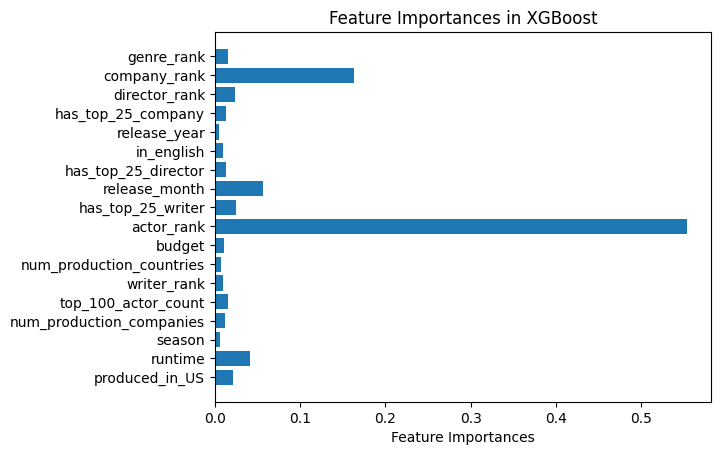

In [437]:
xgb_model = pipeline.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = xgb_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in XGBoost')
plt.show()

### Pipeline for model 2

In [438]:
# Entrenar el modelo
pipeline.fit(X2_train, y2_train)
grid_search_2 = GridSearchCV(pipeline, param_grid_2, cv=10, n_jobs=-1, scoring='neg_mean_absolute_percentage_error')
grid_search_2.fit(X2_train, y2_train)
print("Mejores hiperparámetros:", grid_search_2.best_params_)

Mejores hiperparámetros: {'regressor__colsample_bytree': 1, 'regressor__learning_rate': 0.01, 'regressor__max_depth': 3, 'regressor__n_estimators': 600, 'regressor__subsample': 0.8}


In [439]:
# Realizar predicciones en el conjunto de prueba con el mejor modelo encontrado
best_model_low = grid_search_2.best_estimator_
y2_pred_log = best_model_low.predict(X2_test)

# Revertir la transformación logarítmica
y2_pred = np.expm1(y2_pred_log)
y2_test_actual = np.expm1(y2_test)

In [440]:
mae_low = mean_absolute_error(y2_test_actual, y2_pred)
mape_low = mean_absolute_percentage_error(y2_test_actual, y2_pred) * 100
rmsle_low = np.sqrt(mean_squared_log_error(y2_test_actual, y2_pred))

print(f"MAE for low revenue movies: {mae_low:.2f}")
print(f"MAPE for low revenue movies: {mape_low:.2f}%")
print(f"RMSLE for low revenue movies: {rmsle_low:.2f}")

MAE for low revenue movies: 1519407.27
MAPE for low revenue movies: 21.61%
RMSLE for low revenue movies: 0.30


#### Model importances

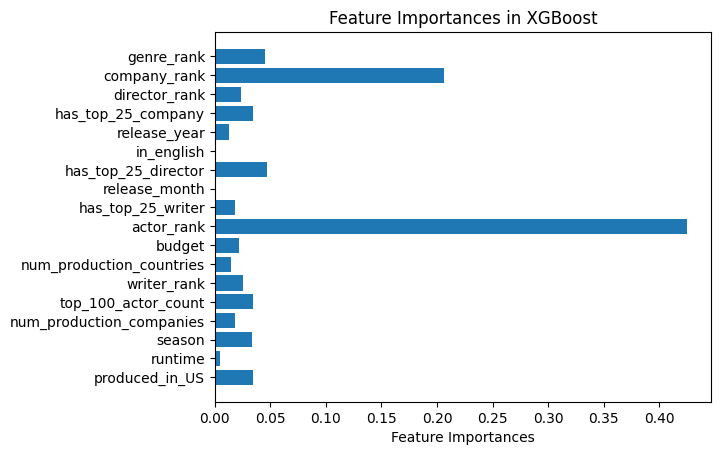

In [394]:
xgb_model = pipeline.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = xgb_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in XGBoost')
plt.show()

- Highest errors for the high revenue movies:

In [318]:
pd.set_option("max_colwidth", 50)
pd.set_option('display.max_columns', 20)
pd.set_option('display.max_rows', 300)
pd.set_option('display.float_format', '{:.2f}'.format)
comparativa = pd.DataFrame({'real': y1_test_actual, 'prediccion': y1_pred})
comparativa['error'] = abs(comparativa['real'] - comparativa['prediccion'])
comparativa['%'] = abs((comparativa['real'] - comparativa['prediccion']) / comparativa['real'])*100

comparativa.sort_values(ascending=False, by='real').head(20)

,real,prediccion,error,%
717,1506249360.00,899431360.00,606818000.00,40.29
1139,1405403694.00,1003684928.00,401718766.00,28.58
1048,1028570889.00,612562752.00,416008137.00,40.45
1035,1021103568.00,1015740736.00,5362832.00,0.53
270,850000000.00,799983040.00,50016960.00,5.88
950,783112979.00,309118240.00,473994739.00,60.53
371,758539785.00,538942656.00,219597129.00,28.95
429,748806957.00,570361728.00,178445229.00,23.83
966,662845518.00,374229312.00,288616206.00,43.54
732,649398328.00,794912000.00,145513672.00,22.41


- Highest errors for the low revenue movies:

In [319]:
pd.set_option("max_colwidth", 50)
pd.set_option('display.max_columns', 20)
pd.set_option('display.max_rows', 300)
pd.set_option('display.float_format', '{:.2f}'.format)
comparativa_2 = pd.DataFrame({'real': y2_test_actual, 'prediccion': y2_pred})
comparativa_2['error'] = abs(comparativa_2['real'] - comparativa_2['prediccion'])
comparativa_2['%'] = abs((comparativa_2['real'] - comparativa_2['prediccion']) / comparativa_2['real'])*100

comparativa_2.sort_values(ascending=False, by='%').head(20)

,real,prediccion,error,%
465,1749201.00,13492807.00,11743606.00,671.37
155,1983204.00,5628663.00,3645459.00,183.82
65,5001655.00,13385661.00,8384006.00,167.62
659,3324330.00,8797865.00,5473535.00,164.65
69,3151130.00,8181241.50,5030111.50,159.63
81,2200000.00,4291561.50,2091561.50,95.07
208,3148182.00,5765320.00,2617138.00,83.13
437,8349430.00,4492112.50,3857317.50,46.20
86,9700000.00,5270723.00,4429277.00,45.66
78,5669831.00,8079645.00,2409814.00,42.50


## Pipeline (Random Forest)

In [90]:
# Seleccionar las columnas numéricas
numeric_features = ['budget', 'top_100_actor_count', 'num_production_countries', 'genre_rank', 'runtime']

# Preprocesamiento de datos
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features)
    ],
    remainder='passthrough'
)

# Crear el pipeline del modelo
pipeline_rf = Pipeline(steps=[
    ('preprocessor', preprocessor),  # Preprocesador definido previamente
    ('regressor', RandomForestRegressor(
    ))
])

In [91]:
param_grid_rf_1 = {
    'regressor__n_estimators': [250, 300, 350],  # Número de árboles
    'regressor__max_depth': [15, 20, 25],        # Profundidad máxima de cada árbol
    'regressor__min_samples_split': [4, 5, 6],  # Mínimo número de muestras necesarias para dividir un nodo
    'regressor__min_samples_leaf': [1, 2, 3],    # Mínimo número de muestras en un nodo hoja
    'regressor__max_features': ['auto', 'sqrt'], # Número de características a considerar para cada división
    'regressor__bootstrap': [True, False]        # Método de muestreo de los datos
}

param_grid_rf_2 = {
    'regressor__n_estimators': [150, 200, 250],  # Número de árboles
    'regressor__max_depth': [25, 30, 35],        # Profundidad máxima de cada árbol
    'regressor__min_samples_split': [1, 2, 3],  # Mínimo número de muestras necesarias para dividir un nodo
    'regressor__min_samples_leaf': [1, 2],    # Mínimo número de muestras en un nodo hoja
    'regressor__max_features': ['auto', 'sqrt'], # Número de características a considerar para cada división
    'regressor__bootstrap': [True, False]        # Método de muestreo de los datos
}

#### Pipeline for model 1

In [92]:
pipeline_rf.fit(X1_train, y1_train)

grid_search_rf_1 = GridSearchCV(
    estimator=pipeline_rf,
    param_grid=param_grid_rf_1,
    cv=10,                  # Número de particiones para la validación cruzada
    n_jobs=-1,              # Utilizar todos los núcleos disponibles
    scoring='neg_mean_absolute_percentage_error',  # Métrica de evaluación
)

grid_search_rf_1.fit(X1_train, y1_train)
print("Mejores hiperparámetros:", grid_search_rf_1.best_params_)

Mejores hiperparámetros: {'regressor__bootstrap': False, 'regressor__max_depth': 20, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 3, 'regressor__min_samples_split': 6, 'regressor__n_estimators': 350}


In [93]:
best_model_rf_high = grid_search_rf_1.best_estimator_
y1_pred_log = best_model_rf_high.predict(X1_test)

# Revertir la transformación logarítmica
y1_pred = np.expm1(y1_pred_log)
y1_test_actual = np.expm1(y1_test)

In [94]:
mae_high = mean_absolute_error(y1_test_actual, y1_pred)
mape_high = mean_absolute_percentage_error(y1_test_actual, y1_pred) * 100
rmsle_high = np.sqrt(mean_squared_log_error(y1_test_actual, y1_pred))

print(f"MAE for high revenue movies: {mae_high:.2f}")
print(f"MAPE for high revenue movies: {mape_high:.2f}%")
print(f"RMSLE for high revenue movies: {rmsle_high:.2f}")

MAE for high revenue movies: 51443832.18
MAPE for high revenue movies: 32.82%
RMSLE for high revenue movies: 0.40


#### Model Importances

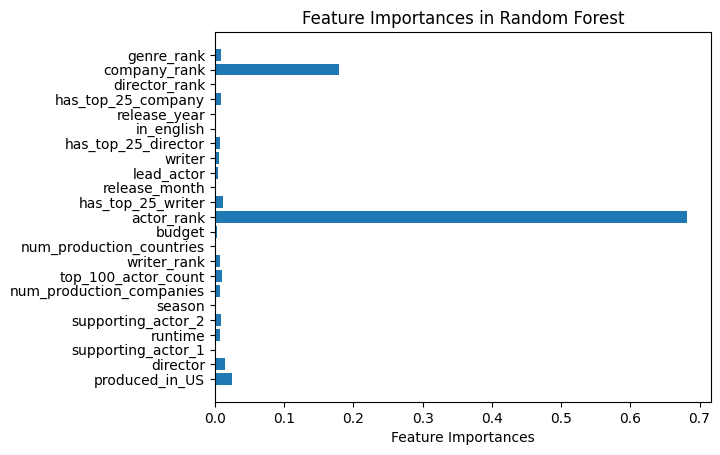

In [95]:
rf_model = pipeline_rf.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = rf_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in Random Forest')
plt.show()

### Pipeline for model 2

In [96]:
pipeline_rf.fit(X2_train, y2_train)
grid_search_rf_2 = GridSearchCV(pipeline_rf, param_grid_rf_2, cv=10, n_jobs=-1, scoring='neg_mean_absolute_percentage_error')
grid_search_rf_2.fit(X2_train, y2_train)
print("Mejores hiperparámetros:", grid_search_rf_2.best_params_)

Mejores hiperparámetros: {'regressor__bootstrap': False, 'regressor__max_depth': 35, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 3, 'regressor__n_estimators': 150}


In [97]:
best_model_rf_low = grid_search_rf_2.best_estimator_
y2_pred_log = best_model_rf_low.predict(X2_test)

# Revertir la transformación logarítmica
y2_pred = np.expm1(y2_pred_log)
y2_test_actual = np.expm1(y2_test)

In [98]:
mae_low = mean_absolute_error(y2_test_actual, y2_pred)
mape_low = mean_absolute_percentage_error(y2_test_actual, y2_pred) * 100
rmsle_low = np.sqrt(mean_squared_log_error(y2_test_actual, y2_pred))

print(f"MAE for low revenue movies: {mae_low:.2f}")
print(f"MAPE for low revenue movies: {mape_low:.2f}%")
print(f"RMSLE for low revenue movies: {rmsle_low:.2f}")

MAE for low revenue movies: 2316324.34
MAPE for low revenue movies: 29.45%
RMSLE for low revenue movies: 0.38


#### Model Importances

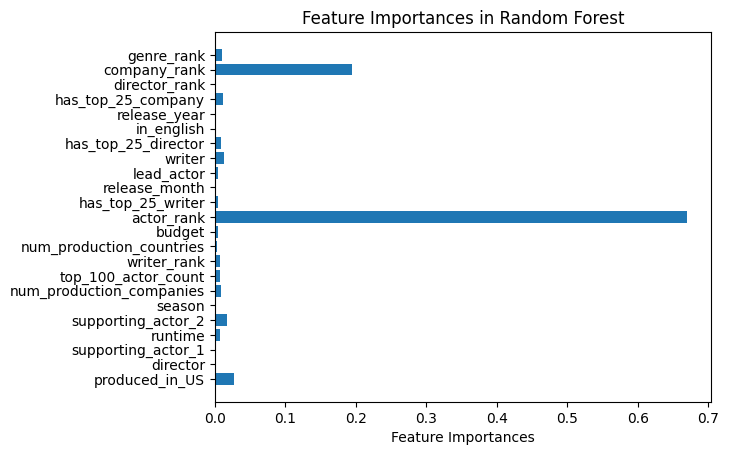

In [99]:
rf_model = pipeline_rf.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = rf_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in Random Forest')
plt.show()

## Pipeline (LightGBM)

In [100]:
# Seleccionar las columnas numéricas
numeric_features = ['budget', 'top_100_actor_count', 'num_production_countries', 'genre_rank', 'runtime']

# Preprocesamiento de datos
numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features)
    ],
    remainder='passthrough'
)

# Crear el pipeline del modelo
pipeline_lgbm = Pipeline(steps=[
    ('preprocessor', preprocessor),  # Preprocesador definido previamente
    ('regressor', LGBMRegressor(force_col_wise=True, 
                                min_data_in_leaf=30,          # Sufficient data in each leaf
                                min_gain_to_split=0.001,      # Minimum gain required for further splits
                                lambda_l1=0.5,                # Some L1 regularization
                                lambda_l2=0.5, 
                                random_state=42
    ))
])

In [101]:
param_grid_lgbm_1 = {
    'regressor__num_leaves': [50, 100, 150],  # Aumento del número de hojas
    'regressor__max_depth': [20, 30, 40],      # Profundidades prácticas
    'regressor__learning_rate': [0.01, 0.1, 0.2],   # Tasa de aprendizaje
    'regressor__n_estimators': [100, 200, 300]      # Número de árboles de aumento
}
param_grid_lgbm_2 = {
    'regressor__num_leaves': [50, 100, 150],  # Aumento del número de hojas
    'regressor__max_depth': [20, 30, 40],      # Profundidades prácticas
    'regressor__learning_rate': [0.01, 0.1, 0.2],   # Tasa de aprendizaje
    'regressor__n_estimators': [100, 200, 300]      # Número de árboles de aumento
}

### Pipeline for model 1

In [102]:
pipeline_lgbm.fit(X1_train, y1_train)
grid_search_lgbm_1 = GridSearchCV(pipeline_lgbm, param_grid_lgbm_1, cv=10, n_jobs=-1, scoring='neg_mean_absolute_percentage_error')
grid_search_lgbm_1.fit(X1_train, y1_train)
print("Mejores hiperparámetros:", grid_search_lgbm_1.best_params_)

[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Info] Total Bins 2646
[LightGBM] [Info] Number of data points in the train

In [103]:
best_model_lgbm_high = grid_search_lgbm_1.best_estimator_
y1_pred_log = best_model_lgbm_high.predict(X1_test)

# Revertir la transformación logarítmica
y1_pred = np.expm1(y1_pred_log)
y1_test_actual = np.expm1(y1_test)

[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30


In [104]:
mae_high = mean_absolute_error(y1_test_actual, y1_pred)
mape_high = mean_absolute_percentage_error(y1_test_actual, y1_pred) * 100
rmsle_high = np.sqrt(mean_squared_log_error(y1_test_actual, y1_pred))

print(f"MAE for low revenue movies: {mae_high:.2f}")
print(f"MAPE for low revenue movies: {mape_high:.2f}%")
print(f"RMSLE for low revenue movies: {rmsle_high:.2f}")

MAE for low revenue movies: 48608071.61
MAPE for low revenue movies: 30.18%
RMSLE for low revenue movies: 0.38


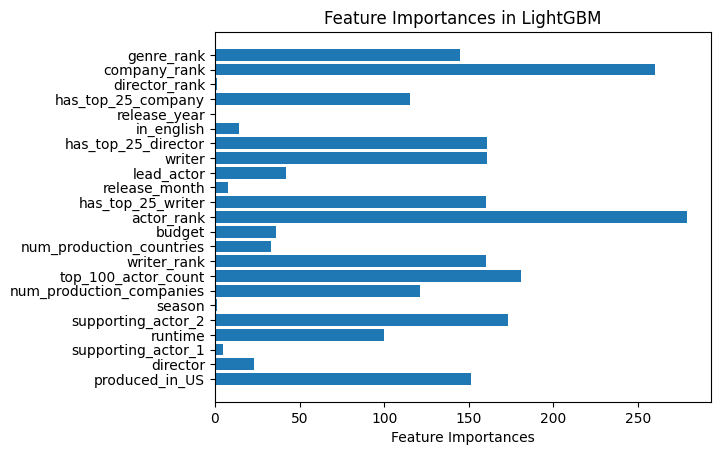

In [105]:
lgbm_model = pipeline_lgbm.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = lgbm_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in LightGBM')
plt.show()

### Pipeline for model 2

In [106]:
pipeline_lgbm.fit(X2_train, y2_train)
grid_search_lgbm_2 = GridSearchCV(pipeline_lgbm, param_grid_lgbm_2, cv=10, n_jobs=-1, scoring='neg_mean_absolute_percentage_error')
grid_search_lgbm_2.fit(X2_train, y2_train)
print("Mejores hiperparámetros:", grid_search_lgbm_2.best_params_)

[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Info] Total Bins 1921
[LightGBM] [Info] Number of data points in the train

In [107]:
best_model_lgbm_low = grid_search_lgbm_2.best_estimator_
y2_pred_log = best_model_lgbm_low.predict(X2_test)

# Revertir la transformación logarítmica
y2_pred = np.expm1(y2_pred_log)
y2_test_actual = np.expm1(y2_test)

[LightGBM] [Warning] lambda_l1 is set=0.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5
[LightGBM] [Warning] lambda_l2 is set=0.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.001, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.001
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30


In [108]:
mae_low = mean_absolute_error(y2_test_actual, y2_pred)
mape_low = mean_absolute_percentage_error(y2_test_actual, y2_pred) * 100
rmsle_low = np.sqrt(mean_squared_log_error(y2_test_actual, y2_pred))

print(f"MAE for low revenue movies: {mae_low:.2f}")
print(f"MAPE for low revenue movies: {mape_low:.2f}%")
print(f"RMSLE for low revenue movies: {rmsle_low:.2f}")

MAE for low revenue movies: 1660785.15
MAPE for low revenue movies: 22.37%
RMSLE for low revenue movies: 0.32


#### Model Importances

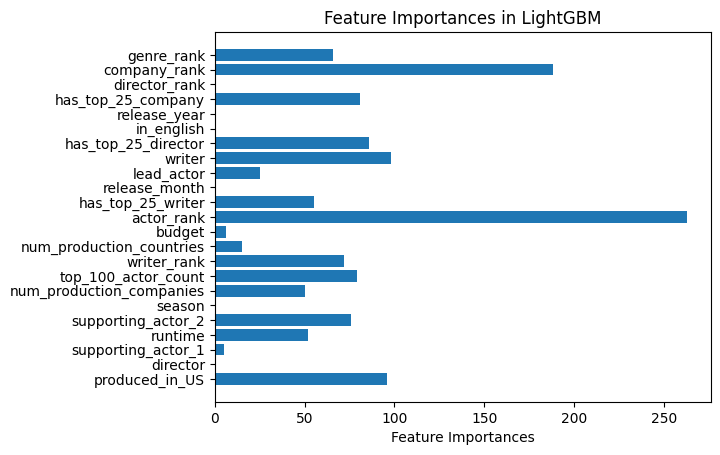

In [109]:
lgbm_model = pipeline_lgbm.named_steps['regressor']

# Obtener las importancias de las características
feature_importances = lgbm_model.feature_importances_

feature_names = X1_train.columns.tolist()

plt.barh(np.arange(len(feature_importances)), feature_importances, align='center')
plt.yticks(np.arange(len(feature_importances)), feature_names)
plt.xlabel('Feature Importances')
plt.title('Feature Importances in LightGBM')
plt.show()

## Conclusions

- The best errors obtained were using XGBoostRegressor, finding: 

1) MAE of 44M, MAPE of 28.12% and RMSLE of 0.36 for high revenues

2) MAE of 1,5M, MAPE of 21,89% and RMSLE of 0.31 for low revenues


These will be the models used to predict new movies in the following steps.

In [442]:
with open('model_high.pkl', 'wb') as file:
    pickle.dump(best_model_high, file)
    
with open('model_low.pkl', 'wb') as file:
    pickle.dump(best_model_low, file)